<h1>Battle of Neighborhoods</h1>

<h3>Webscrap Wiki Page Buenos Aires Neighborhoods</h3>

In [1]:
import requests
pagewiki = requests.get("https://en.wikipedia.org/wiki/Neighbourhoods_of_Buenos_Aires")

In [2]:
from bs4 import BeautifulSoup
soup = BeautifulSoup(pagewiki.content, 'html.parser')

In [3]:
first_table = soup.find("table", class_ = "wikitable sortable")

A=[]
B=[]
C=[]
D=[]

for row in first_table.findAll("tr"):
    cells = row.findAll('td')
    if len(cells)==4: 
        
        mName= cells[0].find(text=True)
        mName= mName.replace('\n', '').replace('\b', '')
        
        mArea= cells[1].find(text=True)
        mArea= mArea.replace('\n', '').replace('\b', '')
        
        mPopulation= cells[2].find(text=True)
        mPopulation= mPopulation.replace('\n', '').replace('\b', '')
        
        mCommune= cells[3].find(text=True)
        mCommune= mCommune.replace('\n', '').replace('\b', '')
        
        A.append(mName)
        B.append(mArea)
        C.append(mPopulation)
        D.append(mCommune)


<h4>Pandas DataFrame</h4>

In [4]:
import pandas as pd
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)


dfcommunes=pd.DataFrame(A,columns=['Name'])
dfcommunes['Area']=B
dfcommunes['Population']=C
dfcommunes['Commune']=D

In [5]:
print("Buenos Aires Communes")
dfcommunes

Buenos Aires Communes


,Name,Area,Population,Commune
0,Agronomía,2.1,"13,963",15
1,Almagro,4.1,"128,206",5
2,Balvanera,4.4,"137,521",3
3,Barracas,7.6,"73,377",4
4,Belgrano,6.8,"126,816",13
5,Boedo,2.6,"45,563",5
6,Caballito,6.8,"170,309",6
7,Chacarita,3.1,"25,778",15
8,Coghlan,1.3,"18,021",12
9,Colegiales,2.3,"52,391",13


<h3>DataFrame with Geospatial Data</h3>

In [6]:
import numpy as np 
import json 
#!conda install -c conda-forge geopy --yes 
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

import requests 
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

# import k-means from clustering stage
from sklearn.cluster import KMeans

#!conda install -c conda-forge folium=0.5.0 --yes 
import folium # map rendering library



In [7]:
#datosba = pd.read_excel('.\\bsas_assets\\comunas.xlsx')
#url='http://cdn.buenosaires.gob.ar/datosabiertos/datasets/informacion-censal-por-radio/CABA_rc.geojson'
url='http://cdn.buenosaires.gob.ar/datosabiertos/datasets/comunas/CABA_comunas.geojson'
datosba= requests.get(url).json()

datosba

{'type': 'FeatureCollection',
 'name': 'comunas',
 'crs': {'type': 'name',
  'properties': {'name': 'urn:ogc:def:crs:OGC:1.3:CRS84'}},
 'features': [{'type': 'Feature',
   'properties': {'BARRIOS': 'RECOLETA',
    'PERIMETRO': 21452.8386478,
    'AREA': 6317264.56099,
    'COMUNAS': 2.0,
    'ID': 1,
    'OBJETO': 'LIMITE COMUNAL'},
   'geometry': {'type': 'MultiPolygon',
    'coordinates': [[[[-58.38000388556933, -34.570023524720185],
       [-58.380024970259136, -34.57036706245849],
       [-58.37983444925949, -34.570352044073054],
       [-58.37952668412939, -34.57032778054891],
       [-58.37952494281349, -34.57032764955404],
       [-58.379523428151735, -34.57032753584111],
       [-58.37952017217587, -34.570327289330336],
       [-58.37951828048224, -34.570327148317],
       [-58.37951691619646, -34.57032704642528],
       [-58.37951365912728, -34.57032680351934],
       [-58.37951040205453, -34.57032656421916],
       [-58.37950811262888, -34.5703263904825],
       [-58.37950715

In [8]:
#url='http://cdn.buenosaires.gob.ar/datosabiertos/datasets/barrios/barrios.geojson'
#results = requests.get(url).json()


In [9]:
#import csv
#import requests

#url='http://cdn.buenosaires.gob.ar/datosabiertos/datasets/barrios/barrios_comunas_p_Ciencia_de_Datos_y_PP.csv'
#with requests.Session() as s:
#    download = s.get(url)

#    decoded_content = download.content.decode('utf-8')

#    cr = csv.reader(decoded_content.splitlines(), delimiter=',')
 
#    barrios=pd.DataFrame(list(cr))

#barrios
 

In [10]:
emp_df = pd.read_csv('.\\bsas_assets\\viviendas-por-condicion-de-ocupacion-por-comuna.csv', sep=',')
emp_df.columns

Index(['Comuna', 'Con todas las personas temporalmente presentes ',
       'Con todas las personas temporalmente ausentes ',
       'En alquiler o venta ', 'En construcción ',
       'Se usa como comercio, oficina o consultorio ',
       'Se usa para vacaciones, fin de semana u otro uso temporal ',
       'Por otra razón '],
      dtype='object')

In [11]:
import matplotlib as mpl
import matplotlib.pyplot as plt

mpl.style.use('ggplot') # optional: for ggplot-like style


In [12]:
emp_df[['Comuna','En alquiler o venta ']]

,Comuna,En alquiler o venta
0,1,5.3
1,2,4.6
2,3,3.7
3,4,2.6
4,5,3.7
5,6,3.8
6,7,3.2
7,8,1.5
8,9,2.7
9,10,3.0


In [13]:
x=emp_df['Comuna'].tolist()
yval=emp_df['En alquiler o venta '].tolist()

x_pos = x #the same that commune number

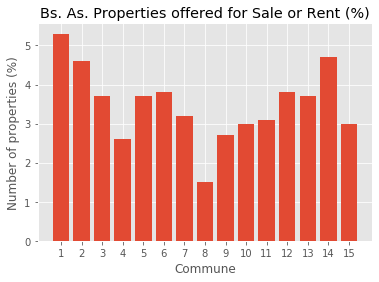

In [14]:
plt.style.use('ggplot')

plt.bar(x,yval)
plt.xlabel('Commune') # add to x-label to the plot
plt.ylabel('Number of properties (%)') # add y-label to the plot
plt.title('Bs. As. Properties offered for Sale or Rent (%)') # add title to the plo
plt.xticks(x_pos,x)

plt.show()

<h4>Average apartment rental price (two room apartments) by Commune (Pesos ARS)</h4>

In [15]:
alq_df = pd.read_csv('.\\bsas_assets\\precio-alquiler-deptos.csv', sep=',')
vta_df = pd.read_csv('.\\bsas_assets\\precio-venta-deptos.csv', sep=',')

alqnonan_df=alq_df[alq_df.precio_prom.notnull()]
is_2019= alqnonan_df['anio']==2019 
alq2019_df = alqnonan_df[is_2019]

is_2d= alq2019_df['ambientes']=='2 ambientes'
alq20192d = alq2019_df[is_2d]
alq20192d_bycommune=alq20192d.groupby(['comuna'],as_index=False).mean()

alq20192d_bycommune



,comuna,anio,precio_prom
0,1,2019,13912.333333
1,2,2019,15522.750000
2,3,2019,13081.666667
3,4,2019,13533.333333
4,5,2019,13970.875000
5,6,2019,13802.250000
6,7,2019,12514.625000
7,8,2019,12526.666667
8,9,2019,12534.000000
9,10,2019,12500.000000


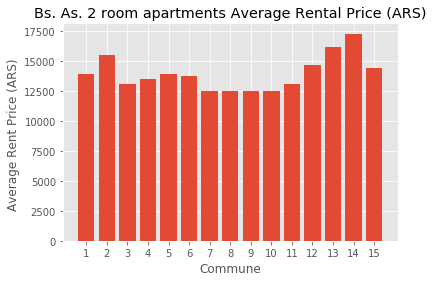

In [16]:
x=alq20192d_bycommune['comuna'].tolist()
yval=alq20192d_bycommune['precio_prom'].tolist()

x_pos = x #the same that commune number

plt.style.use('ggplot')

plt.bar(x,yval)
plt.xlabel('Commune') # add to x-label to the plot
plt.ylabel('Average Rent Price (ARS) ') # add y-label to the plot
plt.title('Bs. As. 2 room apartments Average Rental Price (ARS)') # add title to the plo
plt.xticks(x_pos,x)

plt.show()

<h4>average sale price (square meter) two room apartments (USD) </h4>

In [17]:
vta_df = pd.read_csv('.\\bsas_assets\\precio-venta-deptos.csv', sep=',')
vta_df.head()

,barrio,año,trimestre,precio_prom,ambientes,estado,comuna
0,AGRONOMIA,2010,1,NaN,2 ambientes,Usado,15
1,AGRONOMIA,2010,2,NaN,2 ambientes,Usado,15
2,AGRONOMIA,2010,3,NaN,2 ambientes,Usado,15
3,AGRONOMIA,2010,4,NaN,2 ambientes,Usado,15
4,AGRONOMIA,2011,1,NaN,2 ambientes,Usado,15


In [18]:
vta_df = pd.read_csv('.\\bsas_assets\\precio-venta-deptos.csv', sep=',')

vtanonan_df=vta_df[vta_df.precio_prom.notnull()]
is_2019= vtanonan_df['año']==2019 
vta2019_df = vtanonan_df[is_2019]

is_2d= vta2019_df['ambientes']=='2 ambientes'
vta20192d = vta2019_df[is_2d].drop(['trimestre'],axis=1)

vta20192d_bycommune=vta20192d.groupby('comuna', as_index=False).mean()
vta20192d_bycommune

,comuna,año,precio_prom
0,1,2019,3084.250000
1,2,2019,3371.500000
2,3,2019,2261.500000
3,4,2019,2267.000000
4,5,2019,2559.750000
5,6,2019,2817.000000
6,7,2019,2448.250000
7,8,2019,2448.250000
8,9,2019,2248.500000
9,10,2019,2283.714286


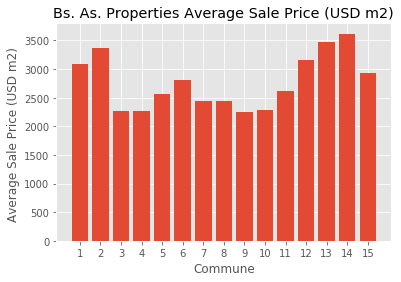

In [19]:
x=vta20192d_bycommune['comuna'].tolist()
yval=vta20192d_bycommune['precio_prom'].tolist()

x_pos = x #the same that commune number

plt.style.use('ggplot')

plt.bar(x,yval)
plt.xlabel('Commune') # add to x-label to the plot
plt.ylabel('Average Sale Price (USD m2) ') # add y-label to the plot
plt.title('Bs. As. Properties Average Sale Price (USD m2)') # add title to the plo
plt.xticks(x_pos,x)

plt.show()

In [20]:
#x=alq20192d_bycommune['Comuna'].tolist()
usdcotiz=83
prices_df=pd.merge(alq20192d_bycommune, vta20192d_bycommune, on='comuna')
prices_df['rentab']=prices_df['precio_prom_x']/(prices_df['precio_prom_y']*usdcotiz)*100
prices_df
#yalq=alq20192d_bycommune['precio_prom'].tolist()
#yalq=prices_df['precio_prom'].tolist()

#yvta=vta20192d_bycommune['precio_prom'].tolist()

#x_pos = x #the same that commune number
#print(len(yalq))
#print(len(yvta))
#print(x)

,comuna,anio,precio_prom_x,año,precio_prom_y,rentab
0,1,2019,13912.333333,2019,3084.250000,5.434659
1,2,2019,15522.750000,2019,3371.500000,5.547118
2,3,2019,13081.666667,2019,2261.500000,6.969288
3,4,2019,13533.333333,2019,2267.000000,7.192422
4,5,2019,13970.875000,2019,2559.750000,6.575790
5,6,2019,13802.250000,2019,2817.000000,5.903165
6,7,2019,12514.625000,2019,2448.250000,6.158628
7,8,2019,12526.666667,2019,2448.250000,6.164554
8,9,2019,12534.000000,2019,2248.500000,6.716124
9,10,2019,12500.000000,2019,2283.714286,6.594626


In [21]:
datosba

{'type': 'FeatureCollection',
 'name': 'comunas',
 'crs': {'type': 'name',
  'properties': {'name': 'urn:ogc:def:crs:OGC:1.3:CRS84'}},
 'features': [{'type': 'Feature',
   'properties': {'BARRIOS': 'RECOLETA',
    'PERIMETRO': 21452.8386478,
    'AREA': 6317264.56099,
    'COMUNAS': 2.0,
    'ID': 1,
    'OBJETO': 'LIMITE COMUNAL'},
   'geometry': {'type': 'MultiPolygon',
    'coordinates': [[[[-58.38000388556933, -34.570023524720185],
       [-58.380024970259136, -34.57036706245849],
       [-58.37983444925949, -34.570352044073054],
       [-58.37952668412939, -34.57032778054891],
       [-58.37952494281349, -34.57032764955404],
       [-58.379523428151735, -34.57032753584111],
       [-58.37952017217587, -34.570327289330336],
       [-58.37951828048224, -34.570327148317],
       [-58.37951691619646, -34.57032704642528],
       [-58.37951365912728, -34.57032680351934],
       [-58.37951040205453, -34.57032656421916],
       [-58.37950811262888, -34.5703263904825],
       [-58.37950715

In [22]:
latitude=-34.6131516
longitude=-58.3772316

map_bsas = folium.Map(location=[latitude, longitude], zoom_start=12,tiles='Mapbox Bright')


map_bsas.choropleth(
    geo_data=datosba,
    data=prices_df,
    columns=['comuna','rentab'],
    key_on='feature.properties.COMUNAS',
    
    fill_color='YlGnBu', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    #smooth_factor=0,
)

map_bsas.save('rentab')
map_bsas

<h3>Metro Stations</h3>

In [23]:
url='http://cdn.buenosaires.gob.ar/datosabiertos/datasets/subte-estaciones/subte_estaciones.geojson'
subw = requests.get(url).json()


In [24]:
from pandas.io.json import json_normalize
df = json_normalize(subw["features"])

column_names = ['Station', 'Line', 'Latitude','Longitude'] 
subwaystations = pd.DataFrame(columns=column_names)

for index,row in df.iterrows():
    mstation=row[2]
    mline=row[3]
    mlatlong=row[5]
    mlat=mlatlong[1]
    mlong=mlatlong[0]

    subwaystations = subwaystations.append({'Station': mstation,
                                          'Line': mline,
                                          'Latitude': mlat,
                                          'Longitude': mlong}, ignore_index=True)
#subwaystation

C:\Users\gdpessat\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: FutureWarning: pandas.io.json.json_normalize is deprecated, use pandas.json_normalize instead
  


<h4></h4>

In [25]:
#Buenos Aires Subway Station Map
latitude=-34.6131516
longitude=-58.3772316
#latitude=43.662696
#longitude=-79.400049

map_subw = folium.Map(location=[latitude, longitude], zoom_start=12)


# add markers to map
for lat, lng, station, line in zip(subwaystations['Latitude'], subwaystations['Longitude'], subwaystations['Station'], subwaystations['Line']):
    label = '{}, {}'.format(station, line)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_subw)  
    
map_subw

In [1]:
# The code was removed by Watson Studio for sharing.

In [27]:
# function that extracts the category of the venue
def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']

In [2]:
def getNearbyVenues(names, latitudes, longitudes, radius=500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Station', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [ ]:
# type your answer here
LIMIT = 100 # limit of number of venues returned by Foursquare API


radius = 500 # define radius

bsas_venues = getNearbyVenues(names=subwaystations['Station'],
                                   latitudes=subwaystations['Latitude'],
                                   longitudes=subwaystations['Longitude']
                                  )

In [30]:
bsas_venues.groupby('Station').count()

,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Station,,,,,,
9 DE JULIO,69,69,69,69,69,69
ACOYTE,37,37,37,37,37,37
AGÜERO,56,56,56,56,56,56
ALBERTI,18,18,18,18,18,18
ALMAGRO - MEDRANO,42,42,42,42,42,42
ANGEL GALLARDO,47,47,47,47,47,47
AV. DE MAYO,66,66,66,66,66,66
AV. LA PLATA,29,29,29,29,29,29
BELGRANO,35,35,35,35,35,35


In [31]:
print('There are {} uniques categories.'.format(len(bsas_venues['Venue Category'].unique())))


There are 228 uniques categories.


In [32]:
# one hot encoding
bsas_onehot = pd.get_dummies(bsas_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
bsas_onehot['Station'] = bsas_venues['Station'] 

# move neighborhood column to the first column
#fixed_columns = [TorontoNeighb_onehot.columns[-1]] + list(TorontoNeighb_onehot.columns[:-1])
#torontoNeighb_onehot = TorontoNeighb_onehot[fixed_columns]
NeighbCol = bsas_onehot['Station']
bsas_onehot.drop(labels=['Station'], axis=1,inplace = True)
bsas_onehot.insert(0, 'Station', NeighbCol)


bsas_onehot


,Station,Accessories Store,Adult Boutique,African Restaurant,American Restaurant,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Astrologer,Athletics & Sports,Auto Dealership,Auto Workshop,BBQ Joint,Bakery,Bank,Bar,Basketball Court,Bed & Breakfast,Beer Bar,Beer Garden,Beer Store,Big Box Store,Bike Rental / Bike Share,Bike Shop,Bistro,Boat or Ferry,Bookstore,Border Crossing,Botanical Garden,Bowling Alley,Breakfast Spot,Brewery,Buffet,Burger Joint,Bus Station,Bus Stop,Business Service,Cafeteria,Café,Camera Store,Candy Store,Cheese Shop,Chinese Restaurant,Chocolate Shop,Church,Clothing Store,Cocktail Bar,Coffee Shop,Comedy Club,Comfort Food Restaurant,Comic Shop,Community Center,Concert Hall,Convenience Store,Cosmetics Shop,Creperie,Cuban Restaurant,Cultural Center,Cupcake Shop,Dance Studio,Deli / Bodega,Department Store,Dessert Shop,Diner,Doctor's Office,Donut Shop,Drugstore,Duty-free Shop,Electronics Store,Empanada Restaurant,Event Space,Fabric Shop,Farmers Market,Fast Food Restaurant,Fish Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Service,Food Truck,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Garden,Garden Center,Gas Station,Gastropub,German Restaurant,Gift Shop,Gluten-free Restaurant,Gourmet Shop,Government Building,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Harbor / Marina,Hardware Store,Health & Beauty Service,Health Food Store,Heliport,Historic Site,History Museum,Hobby Shop,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Intersection,Italian Restaurant,Japanese Restaurant,Jazz Club,Jewish Restaurant,Juice Bar,Kids Store,Korean Restaurant,Kosher Restaurant,Latin American Restaurant,Lawyer,Light Rail Station,Liquor Store,Lounge,Market,Martial Arts Dojo,Mediterranean Restaurant,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Monument / Landmark,Motel,Movie Theater,Moving Target,Multiplex,Museum,Music Store,Music Venue,Nail Salon,Nightclub,Noodle House,Office,Opera House,Optical Shop,Organic Grocery,Other Great Outdoors,Other Nightlife,Outdoor Sculpture,Outdoor Supply Store,Outlet Mall,Paper / Office Supplies Store,Park,Pastry Shop,Pedestrian Plaza,Performing Arts Venue,Perfume Shop,Peruvian Restaurant,Pet Store,Pharmacy,Pilates Studio,Pizza Place,Platform,Playground,Plaza,Pool,Pool Hall,Port,Print Shop,Pub,Record Shop,Residential Building (Apartment / Condo),Restaurant,Rock Club,Russian Restaurant,Salad Place,Salon / Barbershop,Salsa Club,Sandwich Place,School,Science Museum,Seafood Restaurant,Shoe Store,Shopping Mall,Shopping Plaza,Skating Rink,Smoke Shop,Snack Place,Soccer Field,Soccer Stadium,South American Restaurant,Spa,Spanish Restaurant,Speakeasy,Sporting Goods Shop,Sports Club,Stadium,Stationery Store,Steakhouse,Street Food Gathering,Supermarket,Sushi Restaurant,Taco Place,Tapas Restaurant,Tea Room,Tennis Court,Theater,Theme Restaurant,Toy / Game Store,Train Station,Vacation Rental,Vegetarian / Vegan Restaurant,Venezuelan Restaurant,Veterinarian,Video Game Store,Whisky Bar,Wine Bar,Wine Shop,Women's Store,Yoga Studio
0,CASEROS,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,CASEROS,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0

In [33]:
bsas_onehot.shape


(3658, 229)

In [34]:
bsas_grouped = bsas_onehot.groupby('Station').sum().reset_index()
bsas_grouped.head()


,Station,Accessories Store,Adult Boutique,African Restaurant,American Restaurant,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Astrologer,Athletics & Sports,Auto Dealership,Auto Workshop,BBQ Joint,Bakery,Bank,Bar,Basketball Court,Bed & Breakfast,Beer Bar,Beer Garden,Beer Store,Big Box Store,Bike Rental / Bike Share,Bike Shop,Bistro,Boat or Ferry,Bookstore,Border Crossing,Botanical Garden,Bowling Alley,Breakfast Spot,Brewery,Buffet,Burger Joint,Bus Station,Bus Stop,Business Service,Cafeteria,Café,Camera Store,Candy Store,Cheese Shop,Chinese Restaurant,Chocolate Shop,Church,Clothing Store,Cocktail Bar,Coffee Shop,Comedy Club,Comfort Food Restaurant,Comic Shop,Community Center,Concert Hall,Convenience Store,Cosmetics Shop,Creperie,Cuban Restaurant,Cultural Center,Cupcake Shop,Dance Studio,Deli / Bodega,Department Store,Dessert Shop,Diner,Doctor's Office,Donut Shop,Drugstore,Duty-free Shop,Electronics Store,Empanada Restaurant,Event Space,Fabric Shop,Farmers Market,Fast Food Restaurant,Fish Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Service,Food Truck,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Garden,Garden Center,Gas Station,Gastropub,German Restaurant,Gift Shop,Gluten-free Restaurant,Gourmet Shop,Government Building,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Harbor / Marina,Hardware Store,Health & Beauty Service,Health Food Store,Heliport,Historic Site,History Museum,Hobby Shop,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Intersection,Italian Restaurant,Japanese Restaurant,Jazz Club,Jewish Restaurant,Juice Bar,Kids Store,Korean Restaurant,Kosher Restaurant,Latin American Restaurant,Lawyer,Light Rail Station,Liquor Store,Lounge,Market,Martial Arts Dojo,Mediterranean Restaurant,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Monument / Landmark,Motel,Movie Theater,Moving Target,Multiplex,Museum,Music Store,Music Venue,Nail Salon,Nightclub,Noodle House,Office,Opera House,Optical Shop,Organic Grocery,Other Great Outdoors,Other Nightlife,Outdoor Sculpture,Outdoor Supply Store,Outlet Mall,Paper / Office Supplies Store,Park,Pastry Shop,Pedestrian Plaza,Performing Arts Venue,Perfume Shop,Peruvian Restaurant,Pet Store,Pharmacy,Pilates Studio,Pizza Place,Platform,Playground,Plaza,Pool,Pool Hall,Port,Print Shop,Pub,Record Shop,Residential Building (Apartment / Condo),Restaurant,Rock Club,Russian Restaurant,Salad Place,Salon / Barbershop,Salsa Club,Sandwich Place,School,Science Museum,Seafood Restaurant,Shoe Store,Shopping Mall,Shopping Plaza,Skating Rink,Smoke Shop,Snack Place,Soccer Field,Soccer Stadium,South American Restaurant,Spa,Spanish Restaurant,Speakeasy,Sporting Goods Shop,Sports Club,Stadium,Stationery Store,Steakhouse,Street Food Gathering,Supermarket,Sushi Restaurant,Taco Place,Tapas Restaurant,Tea Room,Tennis Court,Theater,Theme Restaurant,Toy / Game Store,Train Station,Vacation Rental,Vegetarian / Vegan Restaurant,Venezuelan Restaurant,Veterinarian,Video Game Store,Whisky Bar,Wine Bar,Wine Shop,Women's Store,Yoga Studio
0,9 DE JULIO,0,0,0,0,0,3,0,0,0,0,0,0,0,0,0,1,0,2,0,0,0,0,0,0,0,0,0,0,4,0,0,0,0,0,0,1,0,0,0,0,10,1,1,0,0,0,0,0,0,6,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,5,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,3,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,3,0,0,1,0,0,0,0,0,0,0,5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,7,0,0,0,0,1,0,0,0,0,0,0,0,0
1,ACOYTE,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,1,0,0,4,0,0,0,0,0,0,0,0,3,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,2,1,0,0,0,0,0,0,0,0,0,0,0,0,5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,

In [35]:
bsas_grouped.shape

(87, 229)

<h3>Top 5 most common venues by Neighborhood</h3>

In [36]:
num_top_venues = 5

for hood in bsas_grouped['Station']:
    print("----"+station+"----")
    temp = bsas_grouped[bsas_grouped['Station'] == hood].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    print('\n')

----CORREO CENTRAL----
         venue  freq
0         Café  10.0
1      Theater   7.0
2  Coffee Shop   6.0
3   Restaurant   5.0
4        Hotel   5.0


----CORREO CENTRAL----
            venue  freq
0  Ice Cream Shop   5.0
1            Café   4.0
2          Bakery   4.0
3     Coffee Shop   3.0
4             Gym   2.0


----CORREO CENTRAL----
                    venue  freq
0                  Bakery   6.0
1             Pizza Place   3.0
2  Argentinian Restaurant   3.0
3          Ice Cream Shop   3.0
4                    Café   3.0


----CORREO CENTRAL----
         venue  freq
0         Café   3.0
1  Pizza Place   2.0
2    BBQ Joint   2.0
3          Gym   2.0
4    Rock Club   1.0


----CORREO CENTRAL----
                    venue  freq
0             Pizza Place   3.0
1                    Café   3.0
2              Restaurant   3.0
3                     Gym   2.0
4  Argentinian Restaurant   2.0


----CORREO CENTRAL----
                    venue  freq
0          Ice Cream Shop   4.0
1  Argen

<h3>Main Venues Categories by Neighborhood</h3>

In [37]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [38]:
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Station']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
station_venues_sorted = pd.DataFrame(columns=columns)
station_venues_sorted['Station'] = bsas_grouped['Station']

for ind in np.arange(bsas_grouped.shape[0]):
    station_venues_sorted.iloc[ind, 1:] = return_most_common_venues(bsas_grouped.iloc[ind, :], num_top_venues)

station_venues_sorted.head()

,Station,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,9 DE JULIO,Café,Theater,Coffee Shop,Hotel,Restaurant,Bookstore,Mediterranean Restaurant,Argentinian Restaurant,Pizza Place,Bar
1,ACOYTE,Ice Cream Shop,Bakery,Café,Coffee Shop,Gym,Burger Joint,Bus Stop,Market,Spa,Fried Chicken Joint
2,AGÜERO,Bakery,Pizza Place,Argentinian Restaurant,Ice Cream Shop,Café,Coffee Shop,Electronics Store,Italian Restaurant,Miscellaneous Shop,Record Shop
3,ALBERTI,Café,Pizza Place,Gym,BBQ Joint,Coffee Shop,Fast Food Restaurant,Gas Station,Rock Club,Supermarket,Gym / Fitness Center
4,ALMAGRO - MEDRANO,Café,Restaurant,Pizza Place,Gym,Bar,Theater,Vegetarian / Vegan Restaurant,Argentinian Restaurant,Garden Center,Bakery


<h3>Cluster Neighborhoods</h3>

<p>I consider up to ten groups, considering that most neighborhoods in Toronto are fairly homogeneous regarding accessibility and category categories of businesses.</p> 

In [39]:
kclusters = 10

bsas_grouped_clustering = bsas_grouped.drop('Station', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(bsas_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10] 

array([4, 5, 0, 5, 5, 0, 3, 8, 5, 0])

In [40]:
# add clustering labels
station_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

bsas_merged = subwaystations

# merge toronto_grouped with toronto_data to add latitude/longitude for each neighborhood
bsas_merged = bsas_merged.join(station_venues_sorted.set_index('Station'), on='Station')

bsas_merged.head()

,Station,Line,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,CASEROS,H,-34.635750,-58.398928,8,Pizza Place,Argentinian Restaurant,Restaurant,Café,Athletics & Sports,Park,Fast Food Restaurant,Event Space,Fabric Shop,Farmers Market
1,INCLAN - MEZQUITA AL AHMAD,H,-34.629376,-58.400970,8,Soccer Field,Pizza Place,Convenience Store,Middle Eastern Restaurant,Supermarket,Empanada Restaurant,Food Service,Food Court,Food & Drink Shop,Food
2,HUMBERTO 1°,H,-34.623092,-58.402323,8,Pizza Place,Pharmacy,Ice Cream Shop,Theater,BBQ Joint,Convenience Store,Cultural Center,Dessert Shop,Bus Stop,Metro Station
3,VENEZUELA,H,-34.615242,-58.404732,8,Bakery,BBQ Joint,Pizza Place,Grocery Store,Pharmacy,Convenience Store,Hotel,Café,Bus Stop,South American Restaurant
4,ONCE - 30 DE DICIEMBRE,H,-34.608935,-58.406036,5,Café,Electronics Store,Fast Food Restaurant,Grocery Store,Pizza Place,Bakery,Cultural Center,Pharmacy,Platform,Concert Hall


In [41]:
clusters=bsas_merged.sort_values(by=["Cluster Labels","Line"])


In [42]:
from pandas import ExcelWriter

writer = ExcelWriter('Clusters.xlsx')
bsas_merged.sort_values(by=["Cluster Labels","Line"]).to_excel(writer,'Sheet1')
writer.save()

# DF TO CSV


<h3>Map Clusters</h3>

<h4>Map containing the segmented neighborhoods according to the most common venues</h4>

In [43]:
# create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=11)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(bsas_merged['Latitude'], bsas_merged['Longitude'], bsas_merged['Station'], bsas_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

<p>datos de Estadística Gobierno Ciudad Buenos aires https://data.buenosaires.gob.ar/dataset/mercado-inmobiliario</p>

In [1]:
latitude=-34.6131516
longitude=-58.3772316

map_todo = folium.Map(location=[latitude, longitude], zoom_start=12,tiles='Mapbox Bright')


map_todo.choropleth(
    geo_data=datosba,
    data=prices_df,
    columns=['comuna','rentab'],
    key_on='feature.properties.COMUNAS',
    
    fill_color='YlGnBu', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    #smooth_factor=0,
)

x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(bsas_merged['Latitude'], bsas_merged['Longitude'], bsas_merged['Station'], bsas_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_todo)

map_todo.save('maptodo.html')    
map_todo

NameError: name 'folium' is not defined